In [2]:
import pandas as pd
import numpy as np
import plotly.express as px
from sklearn.ensemble import IsolationForest

import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Functions

In [3]:
def plot_df_timeseries(df):
    for item in df.columns:
        fig = px.line(df, y=item, title=f'{item} Time Series')
        fig.update_xaxes(rangeslider_visible=True)
            # configure the range slider and selector
        fig.update_xaxes(
        rangeslider_visible=True,
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="Daily", step="day", stepmode="backward"),  
                dict(count=1, label="1-Month", step="month", stepmode="backward"),
                dict(count=6, label="6-Month", step="month", stepmode="backward"),
                dict(count=1, label="YTD", step="year", stepmode="todate"),
                dict(count=1, label="1-Year", step="year", stepmode="backward"),
                dict(step="all")
                        ])
            )
        )
        fig.show()


def plot_outlires(df, data, outliers):
    fig = px.scatter(df, y=data, color=outliers,
                 title="Outliers Plot")
    
    fig.add_trace(go.Scatter(x=df.index, y=df[data], mode='lines', line=dict(color=fig.data[0].marker.color)))
    fig.update_xaxes(rangeslider_visible=True)
    # Update scatter marker properties
    scatter_trace = fig.data[0]  
    scatter_trace.marker.size = 0.1  

    fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="Daily", step="day", stepmode="backward"),  
            dict(count=1, label="1-Month", step="month", stepmode="backward"),
            dict(count=6, label="6-Month", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1-Year", step="year", stepmode="backward"),
            dict(step="all")
                    ])
        )
    )
    fig.update_layout(showlegend=False)

    fig.show()

def plot_2ts(df1, df2):
    df1 = pd.DataFrame(df1)
    df2 = pd.DataFrame(df2)
    fig = make_subplots(specs=[[{"secondary_y": True}]])

    fig.add_trace(go.Scatter(x=df1.index, y=df1[df1.columns[0]], name=df1.columns[0]))

    fig.add_trace(go.Scatter(x=df2.index, y=df2[df2.columns[0]], name=df2.columns[0]), secondary_y=True)

    fig.update_layout(title='Time Series with Rangeslider')

    fig.update_xaxes(rangeslider_visible=True)
    fig.update_yaxes(title_text=df1.columns[0], secondary_y=False)
    fig.update_yaxes(title_text=df2.columns[0], secondary_y=True)
    
    fig.show()

def plot_2ts_scat(df1, colcolor='DOW'): 
    df = pd.concat([pd.DataFrame(price),pd.DataFrame(df1)], axis=1)
    df['DOW'] = df.index.strftime('%A')
    df['HOD'] = df.index.hour
    fig = px.scatter(df, x='price', y=df1.columns[0], color=colcolor)
    fig.show()


In [361]:
from statsmodels.nonparametric.smoothers_lowess import lowess
from pyod.models.knn import KNN

def detect_outliers(df, window_size, starting_date=df.index.min(), 
                                   ending_date=df.index.max(), 
                                   method = 'Rolling_Median',
                                   contamination = 0.01):
    df = df[pd.to_datetime(starting_date):pd.to_datetime(ending_date)]
    if method == 'Rolling_Median':
        resid = df - df.rolling(window_size).median() 
        stdev = resid.std().to_numpy()
        upper_lim = 1.96 * stdev
        lower_lim = -1.96 * stdev
        outliers = np.where((resid > upper_lim) | (resid < lower_lim))[0]
    elif method =='STL':
        resid = df - lowess(df[df.columns[0]], df.index, return_sorted=False)[:, None]
        q_01 = resid.quantile(0.1)
        q_09 = resid.quantile(0.9)
        upper_lim = 2 * (q_09 - q_01)
        lower_lim = -2 * (q_09 - q_01)
        outliers = np.where((resid > upper_lim) | (resid < lower_lim))[0]
    elif method == 'IsolationForest':
        outliers = IsolationForest(contamination=contamination).fit_predict(df) == -1
        outliers = np.where(outliers)[0]
    elif method == 'KNN':
        outliers = KNN(contamination=contamination).fit(df).labels_ == 1
        outliers = np.where(outliers)[0]



    fig = px.scatter(df, title="Outliers Plot")
    # fig.update_traces(marker=dict(color=['red' if i in outliers else 'blue' for i in range(len(df))]))
    fig.update_traces(marker=dict(color=['red' if i in outliers else 'blue' for i in range(len(df))], 
                                  size=[5 if i in outliers else 1 for i in range(len(df))],
                                  line=dict(width=0)))
    fig.add_trace(go.Scatter(x=df.index, y=df[df.columns[0]], mode='lines', line=dict(color='blue', width=1)))
    fig.update_xaxes(rangeslider_visible=True)
    # Update scatter marker properties
    scatter_trace = fig.data[0]  
    # scatter_trace.marker.size = 2  

    fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="Daily", step="day", stepmode="backward"),  
            dict(count=1, label="1-Month", step="month", stepmode="backward"),
            dict(count=6, label="6-Month", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1-Year", step="year", stepmode="backward"),
            dict(step="all")
                    ])
        )
    )
    fig.update_layout(showlegend=False)

    # Add horizontal lines
    if method in ['STL', 'Rolling_Median']:
        fig.add_hline(y=upper_lim[0], line_dash="dash", line_color="red")
        fig.add_hline(y=lower_lim[0], line_dash="dash", line_color="red")

    fig.show()

    ddf = df.copy()
    ddf['is_outlier'] = False
    ddf.loc[df.index.isin(outliers), 'is_outlier'] = True
    return pd.DataFrame(df)

# Data reading, cleaning, wrangling

In [232]:
ail_price = pd.read_csv('~/Slalom/data/ail_price.csv').iloc[:,3:]
ail_price = ail_price.rename(columns={'date':'Date'})
ail_price['Date'] = pd.to_datetime(ail_price['Date'])
ail_price = ail_price.set_index('Date').sort_index()
ail_price = ail_price[pd.to_datetime('2021-01-01 00:00:00'):pd.to_datetime('2023-03-31 22:00:00	')]
price = pd.DataFrame(ail_price['price'])

# Labeling Spikes

In [391]:
# Methods : 'Rolling_Median'(default) , 'STL',  'IsolationForest', 'KNN'
# starting_date = df.index.min()
# ending_date = df.index.max()
# contamination = 0.01
labeled_price = detect_outliers(price, window_size = 24*7, method='KNN')

# ----------------------------------------------------

In [5]:
grand_supply = pd.read_csv('~/Slalom/data/supply.csv', low_memory=False)
grand_supply = grand_supply.rename(columns={'Unnamed: 0':'Date'})
grand_supply['Date'][0] = '1/1/2015 12:00:00 AM'
grand_supply['Date'][1] = '1/1/2015 12:00:00 AM'
grand_supply['Date'] = pd.to_datetime(grand_supply['Date'])
grand_supply = grand_supply.set_index('Date')

In [6]:
index = ['Availability Factor',	'Availability Utilization',	'Capacity Factor',	'Maximum Capacity',	'Total Generation',	'System Capacity',	'System Available',	'System Generation']
ind = index[7]
supply = {}
for column in grand_supply.columns:
    for item in index:
            supply[item] = pd.DataFrame(index=grand_supply.index)

for column in grand_supply.columns:
    supply[grand_supply[column][1]][grand_supply[column][0]] = grand_supply[column]
    
for item in index:   
    supply[item] = supply[item].add_prefix(item +' ')  
    
def str_to_float(s):
    if ',' in s:
        s = s.replace(',', '')
    if '%' in s:
        s = s.rstrip('%')
        return float(s) / 100
    else:
        return float(s)  

for item in index:
    supply[item] = supply[item].iloc[2:]
    supply[item] = supply[item].astype(str)
    supply[item] = supply[item][pd.to_datetime('2021-01-01 00:00:00'):pd.to_datetime('2023-03-31 22:00:00	')]
    for col in supply[item]:
        if supply[item][col].dtype == 'object':
            supply[item][col] = supply[item][col].apply(str_to_float)

In [7]:
generated_power = pd.read_csv('~/Slalom/data/generated_power.csv').drop(['Date', 'Date (MPT)', 'Date (MST)'], axis=1)
generated_power = generated_power.rename(columns={'Date - MST':'Date'})
generated_power['Date'] = pd.to_datetime(generated_power['Date'])
generated_power = generated_power[['Date','Fuel Type', ind ]]
generated_power = generated_power.pivot(index='Date', columns='Fuel Type', values=ind)
generated_power = generated_power.add_prefix('gp_')
generated_power = generated_power[pd.to_datetime('2021-01-01 00:00:00'):pd.to_datetime('2023-03-31 22:00:00	')]

In [8]:
interchange_power = pd.read_csv('~/Slalom/data/interchange_power.csv').drop(['Date (MST)'], axis=1)
interchange_power = interchange_power.rename(columns={'Date - MST':'Date'})
interchange_power['Date'] = pd.to_datetime(interchange_power['Date'])
interchange_power = interchange_power.set_index('Date').sort_index()
interchange_power = interchange_power.add_prefix('ip_')
interchange_power = interchange_power[pd.to_datetime('2021-01-01 00:00:00'):pd.to_datetime('2023-03-31 22:00:00	')]

In [9]:
outage_power = pd.read_csv('~/Slalom/data/outage_power.csv').drop(['Hourly Profile', 'Season', 'Date (MST)'], axis=1)
outage_power = outage_power.rename(columns={'Date - MST':'Date'})
outage_power['Date'] = pd.to_datetime(outage_power['Date'])
outage_power = outage_power.set_index('Date').sort_index()
outage_power = outage_power.add_prefix('op_')
outage_power = outage_power[pd.to_datetime('2021-01-01 00:00:00'):pd.to_datetime('2023-03-31 22:00:00	')]

In [10]:
regional_load = pd.read_csv('~/Slalom/data/regonal_load_data.csv').drop(['Date', 'Hourly Profile','Season', 'Date (MPT)', 'Date (MST)'], axis=1)
regional_load = regional_load.rename(columns={'Date - MST':'Date'})
regional_load['Date'] = pd.to_datetime(regional_load['Date'])
regional_load = regional_load.set_index('Date').sort_index()
regional_load = regional_load[pd.to_datetime('2021-01-01 00:00:00'):pd.to_datetime('2023-03-31 22:00:00	')]

Checking for missing values

In [131]:
df = supply[index[7]]['System Generation Gas Fired Steam']
expected_range = pd.date_range(start=df.index.min(), end=df.index.max(), freq='H')

# Find the missing dates by comparing the expected range with the actual index
missing_dates = expected_range[~expected_range.isin(df.index)]

# Print the missing dates
print("Missing dates:")
print(missing_dates)
missing_dates.shape

Missing dates:
DatetimeIndex([], dtype='datetime64[ns]', freq='H')


(0,)

In [130]:
supply[index[7]]

,System Generation Coal,System Generation Cogeneration,System Generation Combined Cycle,System Generation Dual Fuel,System Generation Gas Fired Steam,System Generation Hydro,System Generation Other,System Generation Simple Cycle,System Generation Solar,System Generation Storage,System Generation Wind
Date,,,,,,,,,,,
2021-01-01 00:00:00,1856.0,1669.0,1110.0,139.0,NaN,56.0,77.0,253.0,0.0,0.0,1470.0
2021-01-01 01:00:00,1688.0,1660.0,1143.0,137.0,NaN,72.0,81.0,241.0,0.0,0.0,1524.0
2021-01-01 02:00:00,1529.0,1696.0,1111.0,137.0,NaN,94.0,79.0,241.0,0.0,0.0,1534.0
2021-01-01 03:00:00,1424.0,1703.0,1144.0,137.0,NaN,94.0,78.0,242.0,0.0,0.0,1483.0
2021-01-01 04:00:00,1497.0,1695.0,1139.0,137.0,NaN,69.0,83.0,242.0,0.0,0.0,1446.0
...,...,...,...,...,...,...,...,...,...,...,...
2023-03-31 18:00:00,798.0,1707.0,1259.0,465.0,938.0,153.0,80.0,146.0,81.0,0.0,2120.0
2023-03-31 19:00:00,801.0,1708.0,1260.0,464.0,896.0,152.0,81.0,146.0,0.0,0.0,2257.0
2023-03-31 20:00:00,799.0,1711.0,1248.0,465.0,996.0,125.0,84.0,146.0,0.0,0.0,2337.0


Grand data set for the model input

In [40]:
model_df =  pd.concat([outliers,
                       price, 
                       ail , 
                    #    supply[index[0]],
                    #    supply[index[1]],
                    #    supply[index[2]],
                    #    supply[index[3]],
                    #    supply[index[4]],
                    #    supply[index[5]],
                    #    supply[index[6]],
                       supply[index[7]], 
                       interchange_power, 
                       outage_power, 
                       regional_load], axis=1)

In [41]:
# Define the number of lags
num_lags = 12

# Iterate over each column (feature) in the DataFrame
for column in model_df.columns:
    # Create lagged columns
    for lag in range(1, num_lags+1):
        model_df[f'{column}_lag_{lag}'] = model_df[column].shift(lag)

C:\Users\mehdi\AppData\Local\Temp\ipykernel_13548\312804458.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  model_df[f'{column}_lag_{lag}'] = model_df[column].shift(lag)
C:\Users\mehdi\AppData\Local\Temp\ipykernel_13548\312804458.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  model_df[f'{column}_lag_{lag}'] = model_df[column].shift(lag)
C:\Users\mehdi\AppData\Local\Temp\ipykernel_13548\312804458.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, wh

In [42]:
model_df.shape

(19679, 559)

In [43]:
model_df.head()

,Outliers,price,ail,System Generation Coal,System Generation Cogeneration,System Generation Combined Cycle,System Generation Dual Fuel,System Generation Gas Fired Steam,System Generation Hydro,System Generation Other,...,System Load_lag_3,System Load_lag_4,System Load_lag_5,System Load_lag_6,System Load_lag_7,System Load_lag_8,System Load_lag_9,System Load_lag_10,System Load_lag_11,System Load_lag_12
Date,,,,,,,,,,,,,,,,,,,,,
2021-01-01 00:00:00,True,29.92,9655,1856.0,1669.0,1110.0,139.0,NaN,56.0,77.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 01:00:00,True,27.48,9513,1688.0,1660.0,1143.0,137.0,NaN,72.0,81.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 02:00:00,True,28.62,9437,1529.0,1696.0,1111.0,137.0,NaN,94.0,79.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 03:00:00,True,33.55,9376,1424.0,1703.0,1144.0,137.0,NaN,94.0,78.0,...,6659.643861,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 04:00:00,True,35.36,9356,1497.0,1695.0,1139.0,137.0,NaN,69.0,83.0,...,6548.331824,6659.643861,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# EDA

In [231]:
plot_2ts_scat(pd.DataFrame(supply[index[7]][supply[index[7]].columns[0]]), colcolor='HOD')

# Anomaly Detection

### Isolation Forest

In [75]:
df = price.copy()

In [190]:
df

,price,ail
Date,,
2021-01-01 00:00:00,29.92,9655
2021-01-01 01:00:00,27.48,9513
2021-01-01 02:00:00,28.62,9437
2021-01-01 03:00:00,33.55,9376
2021-01-01 04:00:00,35.36,9356
...,...,...
2023-03-31 18:00:00,50.86,10016
2023-03-31 19:00:00,49.35,10121
2023-03-31 20:00:00,51.28,10075


In [76]:
train = df[:16000]
test = df[16000:]

# X_train = train['price'].values.reshape(-1,1)

In [191]:
test

,price
Date,
2022-10-29 16:00:00,96.46
2022-10-29 17:00:00,101.22
2022-10-29 18:00:00,90.04
2022-10-29 19:00:00,69.25
2022-10-29 20:00:00,70.07
...,...
2023-03-31 18:00:00,50.86
2023-03-31 19:00:00,49.35
2023-03-31 20:00:00,51.28


In [79]:
import warnings

# contamination parameter specifies the percentage of data points to be anomalous
cont = 0.01
Spikes_IF = IsolationForest(contamination = cont).fit_predict(train) == -1
outliers = pd.DataFrame(Spikes_IF, columns=['Outliers'], index=train.index)
result = pd.concat([train, outliers], axis=1)
stdval = result.groupby('Outliers')['price'].std()
minn = stdval[1] * stdval[0]

for i in np.arange(0.01, 0.51, 0.01):
    warnings.filterwarnings('ignore', category=UserWarning)
    Spikes_IF = IsolationForest(contamination = i).fit_predict(train) == -1
    outliers = pd.DataFrame(Spikes_IF, columns=['Outliers'], index=train.index)
    result = pd.concat([train, outliers], axis=1)
    stdval = result.groupby('Outliers')['price'].std()
    if (stdval[1] * stdval[0]) < minn:
        minn = stdval[1] * stdval[0]
        cont = i
# plot_outlires(result, 'price', 'Outliers')


In [181]:
cont

0.49

In [230]:
Spikes_IF = IsolationForest(contamination = 0.1)
X_train = train['price'].values.reshape(-1,1)
Spikes_IF.fit(X_train)
outliers = pd.DataFrame(Spikes_IF.predict(X_train), columns=['Outliers'], index=train.index)
result = pd.concat([train, outliers], axis=1)
result['Outliers'] = result['Outliers'].replace({1: False, -1: True})
plot_outlires(result, 'price', 'Outliers')


In [187]:
plot_outlires(result, 'price', 'Outliers')

### prediction

In [188]:
X_test = test['price'].values.reshape(-1,1)

outliers_pred = pd.DataFrame(Spikes_IF.predict(X_test), columns=['Outliers'], index=test.index)
result_pred = pd.concat([test, outliers_pred], axis=1)
result_pred['Outliers'] = result_pred['Outliers'].replace({1: False, -1: True})

In [189]:
plot_outlires(result_pred, 'price', 'Outliers')

In [105]:
result_pred

,price,Outliers
Date,,
2022-10-29 16:00:00,96.46,True
2022-10-29 17:00:00,101.22,True
2022-10-29 18:00:00,90.04,True
2022-10-29 19:00:00,69.25,False
2022-10-29 20:00:00,70.07,False
...,...,...
2023-03-31 18:00:00,50.86,False
2023-03-31 19:00:00,49.35,False
2023-03-31 20:00:00,51.28,False


In [108]:
conda install fbprophet

^C

Note: you may need to restart the kernel to use updated packages.


### Clustering-based anomaly detection


In [154]:
df =  pd.concat([price, 
                ail , 
            #    supply[index[0]],
            #    supply[index[1]],
            #    supply[index[2]],
            #    supply[index[3]],
            #    supply[index[4]],
            #    supply[index[5]],
            #    supply[index[6]],
                # supply[index[7]], 
                # interchange_power, 
                # outage_power['op_Combined Cycle'], 
                # outage_power['op_Hydro'],
                # outage_power['op_Storage'],
                # outage_power['op_Wind'],
                # regional_load
                ],
                 axis=1)

In [140]:
outage_power

,op_Coal,op_Combined Cycle,op_Dual Fuel,op_Gas Fired Steam,op_Hydro,op_Simple Cycle,op_Solar,op_Storage,op_Wind
Date,,,,,,,,,
2021-01-01 00:00:00,850,115,0.0,NaN,183.3,109.4,0.0,8.0,15.0
2021-01-01 01:00:00,1245,115,0.0,NaN,183.3,109.4,0.0,8.0,15.0
2021-01-01 02:00:00,975,117,0.0,NaN,183.3,109.4,0.0,8.0,15.0
2021-01-01 03:00:00,1092,117,0.0,NaN,183.3,111.4,0.0,8.0,15.0
2021-01-01 04:00:00,1070,117,0.0,NaN,183.3,111.4,0.0,8.0,15.0
...,...,...,...,...,...,...,...,...,...
2023-03-31 18:00:00,0,162,0.0,43.0,252.3,546.4,82.0,0.0,386.0
2023-03-31 19:00:00,0,159,0.0,43.0,252.3,545.4,105.0,0.0,391.0
2023-03-31 20:00:00,0,153,0.0,43.0,253.3,545.4,130.0,0.0,396.0


In [139]:
plot_df_timeseries(outage_power)

c:\Users\mehdi\miniconda3\envs\power_price_pred\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\mehdi\miniconda3\envs\power_price_pred\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\mehdi\miniconda3\envs\power_price_pred\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\mehdi\miniconda3\envs\power_price_pred\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\mehdi\miniconda

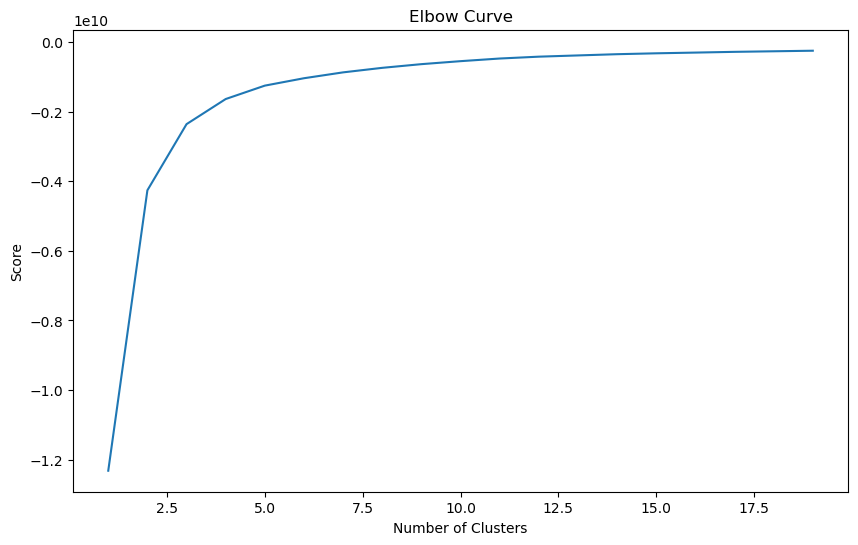

In [155]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

data = df.copy()
n_cluster = range(1, 20)
kmeans = [KMeans(n_clusters=i).fit(data) for i in n_cluster]
scores = [kmeans[i].score(data) for i in range(len(kmeans))]
fig, ax = plt.subplots(figsize=(10,6))
ax.plot(n_cluster, scores)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Curve')
plt.show();

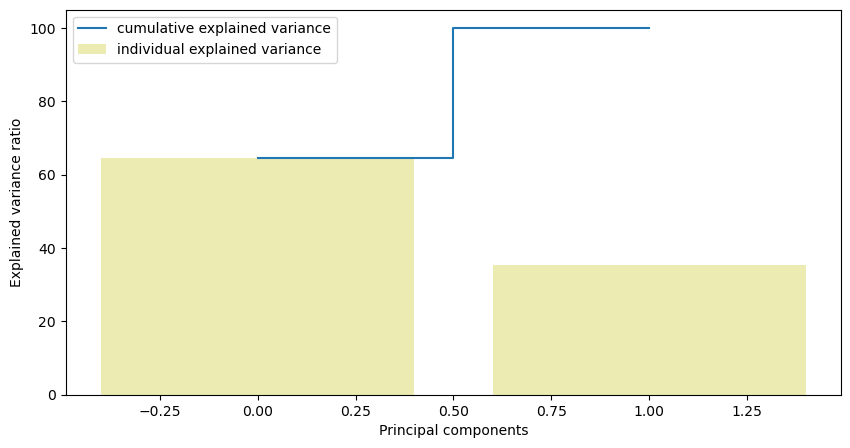

In [156]:
from sklearn.preprocessing import StandardScaler

X = data.values
X_std = StandardScaler().fit_transform(X)
#Calculating Eigenvecors and eigenvalues of Covariance matrix
mean_vec = np.mean(X_std, axis=0)
cov_mat = np.cov(X_std.T)
eig_vals, eig_vecs = np.linalg.eig(cov_mat)
# Create a list of (eigenvalue, eigenvector) tuples
eig_pairs = [ (np.abs(eig_vals[i]),eig_vecs[:,i]) for i in range(len(eig_vals))]
eig_pairs.sort(key = lambda x: x[0], reverse= True)
# Calculation of Explained Variance from the eigenvalues
tot = sum(eig_vals)
var_exp = [(i/tot)*100 for i in sorted(eig_vals, reverse=True)] # Individual explained variance
cum_var_exp = np.cumsum(var_exp) # Cumulative explained variance
plt.figure(figsize=(10, 5))
plt.bar(range(len(var_exp)), var_exp, alpha=0.3, align='center', label='individual explained variance', color = 'y')
plt.step(range(len(cum_var_exp)), cum_var_exp, where='mid',label='cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal components')
plt.legend(loc='best')
plt.show();

In [160]:
# return Series of distance between each point and its distance with the closest centroid
def getDistanceByPoint(data, model):
   distance = pd.Series()
   for i in range(0,len(data)):
       Xa = np.array(data.loc[i])
       Xb = model.cluster_centers_[model.labels_[i]-1]
       distance.at[i]=np.linalg.norm(Xa-Xb)
   return distance
outliers_fraction = 0.1
# get the distance between each point and its nearest centroid. The biggest distances are considered as anomaly
distance = getDistanceByPoint(data, kmeans[9])
number_of_outliers = int(outliers_fraction*len(distance))
threshold = distance.nlargest(number_of_outliers).min()
# anomaly1 contain the anomaly result of the above method Cluster (0:normal, 1:anomaly)
df['anomaly1'] = (distance >= threshold).astype(int)
fig, ax = plt.subplots(figsize=(10,6))
colors = {0:'blue', 1:'red'}
ax.scatter(df['principal_feature1'], df['principal_feature2'], c=df["anomaly1"].apply(lambda x: colors[x]))
plt.xlabel('principal feature1')
plt.ylabel('principal feature2')
plt.show();

C:\Users\mehdi\AppData\Local\Temp\ipykernel_13548\3767996867.py:3: FutureWarning:

The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.



KeyError: 0

In [168]:
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 19679 entries, 2021-01-01 00:00:00 to 2023-03-31 22:00:00
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   price   19679 non-null  float64
 1   ail     19679 non-null  int64  
dtypes: float64(1), int64(1)
memory usage: 461.2 KB


In [162]:
getDistanceByPoint(price, kmeans[9])

C:\Users\mehdi\AppData\Local\Temp\ipykernel_13548\3767996867.py:3: FutureWarning:

The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.



KeyError: 0

In [152]:
data

,price,ail,Calgary,Central,Edmonton,Losses,Northeast,Northwest,South,System Load
Date,,,,,,,,,,
2021-01-01 00:00:00,29.92,9655,980.722146,1171.473099,1358.532734,236.922400,1174.421179,917.347644,820.224659,6659.643861
2021-01-01 01:00:00,27.48,9513,930.446202,1176.854575,1319.084992,232.749707,1169.068763,921.311098,798.816485,6548.331824
2021-01-01 02:00:00,28.62,9437,892.964253,1185.751442,1308.038703,230.711068,1153.448009,914.739715,789.838124,6475.491314
2021-01-01 03:00:00,33.55,9376,874.536088,1176.828153,1292.884711,219.980539,1142.044135,868.807503,783.263951,6358.345079
2021-01-01 04:00:00,35.36,9356,873.012668,1177.172785,1287.351410,255.139984,1139.851965,843.089582,785.215591,6360.833986
...,...,...,...,...,...,...,...,...,...,...
2023-03-31 18:00:00,50.86,10016,1184.827651,1270.078885,1505.557407,274.168699,1139.888577,824.667012,809.196452,7008.384683
2023-03-31 19:00:00,49.35,10121,1198.211300,1290.813091,1542.424524,236.579888,1147.847548,840.182919,859.627254,7115.686525
2023-03-31 20:00:00,51.28,10075,1166.822035,1283.354288,1521.021311,308.861723,1159.560233,841.800181,852.534648,7133.954418


In [ ]:
df = df.sort_values('date_time')
fig, ax = plt.subplots(figsize=(10,6))
a = df.loc[df['anomaly1'] == 1, ['date_time', 'price_usd']] #anomaly
ax.plot(pd.to_datetime(df['date_time']), df['price_usd'], color='k',label='Normal')
ax.scatter(pd.to_datetime(a['date_time']),a['price_usd'], color='red', label='Anomaly')
ax.xaxis_date()
plt.xlabel('Date Time')
plt.ylabel('price in USD')
plt.legend()
fig.autofmt_xdate()
plt.show()

In [177]:
import numpy as np
import pandas as pd
from pyod.models.auto_encoder import AutoEncoder
from pyod.utils.data import generate_data
contamination = 0.1  # percentage of outliers
n_train = 500  # number of training points
n_test = 500  # number of testing points
n_features = 25 # Number of features
X_train, y_train, X_test, y_test = generate_data(
   n_train=n_train, n_test=n_test,
   n_features= n_features,
   contamination=contamination,random_state=1234)
X_train = pd.DataFrame(X_train)
X_test = pd.DataFrame(X_test)

ModuleNotFoundError: No module named 'pyod'

In [55]:
from sktime.forecasting.model_selection import (
    CutoffSplitter,
    ExpandingWindowSplitter,
    SingleWindowSplitter,
    SlidingWindowSplitter,
    temporal_train_test_split,
)
from sktime.utils.plotting import plot_series
from sktime.forecasting.base import ForecastingHorizon

In [56]:
def get_windows(y, cv):
    """Generate windows"""
    train_windows = []
    test_windows = []
    for i, (train, test) in enumerate(cv.split(y)):
        train_windows.append(train)
        test_windows.append(test)
    return train_windows, test_windows

In [57]:
train, test = temporal_train_test_split(model_df, test_size=0.2)

cv = SlidingWindowSplitter(window_length=7*24, fh=12
#                            , step_length=5
                          )

n_splits = cv.get_n_splits(train)
print(f"Number of Folds = {n_splits}")

Number of Folds = 15564


In [58]:
train_windows, test_windows = get_windows(train, cv)

In [59]:
train_windows[0]

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167],
      dtype=int64)

In [62]:
test_windows[0]

array([179], dtype=int64)

In [63]:
model_df.index[train_windows[1][-1]]

Timestamp('2021-01-08 00:00:00')

In [ ]:
results_df = pd.DataFrame(columns=['Date','Data', 'RMSE'])
ddf = pd.DataFrame(columns=['HistoricalPrice',	'FuturePrice',	'Predicted', 'timestep'])

for i in range(n_splits):
    df = model_df.iloc[train_windows[i][0]:train_windows[i][-1],:]
    model = VAR(df)
    result = model.fit()
    # Predict on test set
    lag_order = result.k_ar
    predictions = result.forecast(test.values, 12)
    rmse = np.sqrt(mean_squared_error(predictions, model_df.iloc[train_windows[i][-1]:train_windows[i][-1]+12,:]))
    date_index = pd.date_range(start=model_df.index[train_windows[i][-1]], end=model_df.index[train_windows[i][-1]]+ pd.Timedelta(hours=11), freq='H')
    hist = pd.DataFrame(model_df.iloc[train_windows[i][0]:train_windows[i][-1],:]['price']).rename(columns={'price':'HistoricalPrice'})
    fitu = pd.DataFrame(model_df.iloc[train_windows[i][-1]:train_windows[i][-1]+12,:]['price']).rename(columns={'price':'FuturePrice'})
    pred = pd.DataFrame(predictions[:,1], index=date_index, columns=['Predicted'])
    histfitu = pd.merge(hist, fitu, how='outer', left_index=True, right_index=True)
    hfp = pd.merge(histfitu, pred, how='outer', left_index=True, right_index=True)
    hfp['timestep']=train_windows[i][-1]
    hfp['periodstep'] = range(1, len(hfp)+1)
    hfp = hfp.reset_index()
    results_df = results_df.append({'Date':model_df.index[train_windows[i][-1]],
                                    'Data' : hfp,
                                    'RMSE': rmse}, ignore_index=True)
    ddf = pd.concat([ddf,hfp], axis=0)

In [45]:
from sklearn.model_selection import train_test_split

training_data, testing_data = train_test_split(model_df, test_size=0.2)
print(f"No. of training examples: {training_data.shape[0]}")
print(f"No. of testing examples: {testing_data.shape[0]}")

No. of training examples: 15743
No. of testing examples: 3936


In [46]:
x_train, y_train = training_data.drop("Outliers", axis=1), training_data['Outliers']
x_test, y_test   = testing_data.drop("Outliers", axis=1) , testing_data['Outliers']

In [114]:
result

,price,Outliers
Date,,
2021-01-01 00:00:00,29.92,True
2021-01-01 01:00:00,27.48,True
2021-01-01 02:00:00,28.62,True
2021-01-01 03:00:00,33.55,True
2021-01-01 04:00:00,35.36,True
...,...,...
2023-03-31 18:00:00,50.86,False
2023-03-31 19:00:00,49.35,False
2023-03-31 20:00:00,51.28,False


In [179]:
plot_2ts(supply[index[7]][supply[index[7]].columns[3]], price)

In [171]:
plot_2ts(supply[index[7]][supply[index[7]].columns[7]], price)

In [199]:
plot_2ts(interchange_power[interchange_power.columns[4]], price)

In [206]:
plot_2ts(interchange_power[interchange_power.columns[11]], price)

In [221]:
import numpy as np
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt

X = price['price'].values

# DBSCAN parameters
epsilon = 0.3  # maximum distance between two samples to be considered neighbors
min_samples = 5  # minimum number of samples in a neighborhood for a point to be considered a core point

# Perform DBSCAN clustering
dbscan = DBSCAN(eps=epsilon, min_samples=min_samples)
dbscan.fit(X)

# Extract anomaly labels (-1 represents an anomaly)
anomaly_labels = np.where(dbscan.labels_ == -1)[0]

# Plotting the time series and detected anomalies
plt.figure(figsize=(12, 6))
plt.plot(time_series, label='Time Series')
plt.scatter(anomaly_labels, time_series[anomaly_labels], color='red', label='Anomaly')
plt.xlabel('Time')
plt.ylabel('Value')
plt.title('Anomaly Detection using DBSCAN')
plt.legend()
plt.show()


ValueError: Expected 2D array, got 1D array instead:
array=[37.45 34.62 22.8  ... 51.28 48.39 46.38].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

In [215]:
X.info

<bound method Series.info of Date
2015-01-01 00:00:00    37.45
2015-01-01 01:00:00    34.62
2015-01-01 02:00:00    22.80
2015-01-01 03:00:00    21.05
2015-01-01 04:00:00    20.79
                       ...  
2023-03-31 18:00:00    50.86
2023-03-31 19:00:00    49.35
2023-03-31 20:00:00    51.28
2023-03-31 21:00:00    48.39
2023-03-31 22:00:00    46.38
Name: price, Length: 72287, dtype: float64>

In [117]:
model_df = result.copy()

In [115]:
from sktime.forecasting.model_selection import (
    CutoffSplitter,
    ExpandingWindowSplitter,
    SingleWindowSplitter,
    SlidingWindowSplitter,
    temporal_train_test_split,
)
from sktime.utils.plotting import plot_series
from sktime.forecasting.base import ForecastingHorizon

In [116]:
def get_windows(y, cv):
    """Generate windows"""
    train_windows = []
    test_windows = []
    for i, (train, test) in enumerate(cv.split(y)):
        train_windows.append(train)
        test_windows.append(test)
    return train_windows, test_windows

In [118]:
train, test = temporal_train_test_split(model_df, test_size=0.2)

cv = SlidingWindowSplitter(window_length=7*24, fh=12
#                            , step_length=5
                          )

n_splits = cv.get_n_splits(train)
print(f"Number of Folds = {n_splits}")

Number of Folds = 15564


In [119]:
train_windows, test_windows = get_windows(train, cv)

In [129]:
train_windows[0]

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167],
      dtype=int64)

In [128]:
test_windows[0]

array([179], dtype=int64)

In [130]:
model_df.index[train_windows[1][-1]]

Timestamp('2021-01-08 00:00:00')

In [201]:
ail_price = pd.read_csv('~/Slalom/data/ail_price.csv').iloc[:,3:]
ail_price = ail_price.rename(columns={'date':'Date'})
ail_price['Date'] = pd.to_datetime(ail_price['Date'])
ail_price = ail_price.set_index('Date').sort_index()
# ail_price = ail_price[pd.to_datetime('2021-01-01 00:00:00'):pd.to_datetime('2023-03-31 22:00:00	')]
price = pd.DataFrame(ail_price['price'])
ail = pd.DataFrame(ail_price['ail'])

In [208]:
from sklearn.metrics import mean_squared_error
price['pred'] = price['price'].shift(1)
rmse = np.sqrt(mean_squared_error(price[1:]['price'], price[1:]['pred']))
print("RMSE:", rmse)

RMSE: 63.3845310364023


In [209]:
plot_2ts(price[1:]['price'], price[1:]['pred'])